In [12]:
import requests
from PIL import Image

In [13]:
subscription_key = '32dbcc14bef049d5b3c381cdac8c7f53'

In [14]:
assert subscription_key

In [15]:
face_api_url = 'https://cntr2020.cognitiveservices.azure.com/face/v1.0/detect'

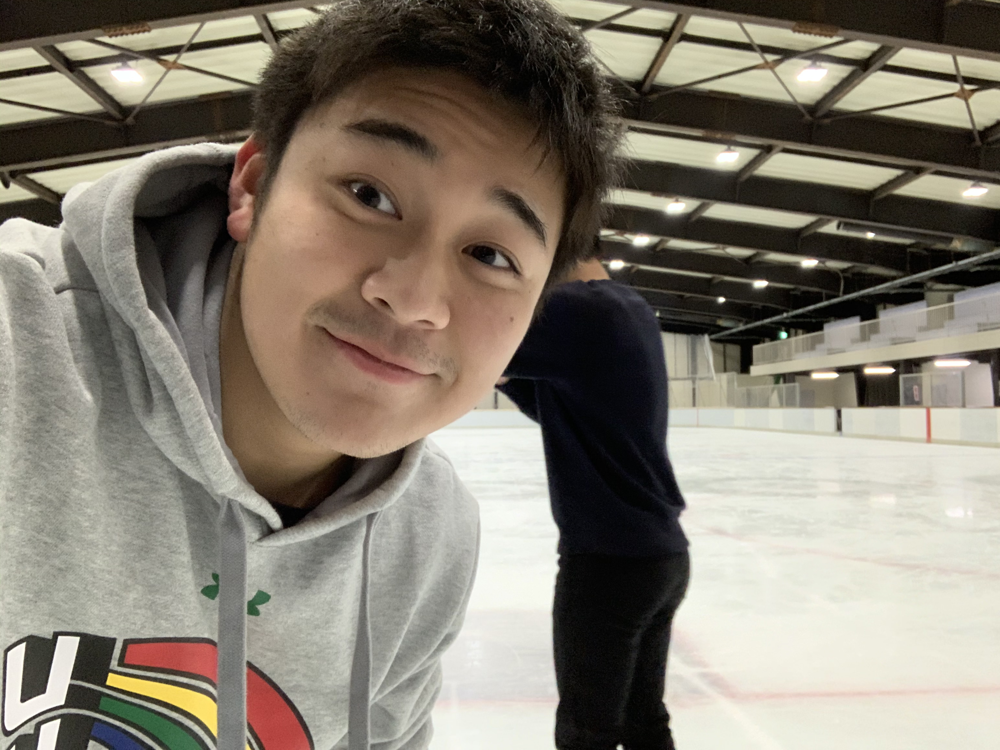

In [36]:
img = Image.open('IMG_3882.jpg')
img

In [17]:
with open('IMG_3882.jpg', 'rb') as f:
    binary_img = f.read()

In [19]:
# binary_img

In [24]:
headers = {
    'Content-type': 'application/octet-stream',
    'Ocp-Apim-Subscription-Key': subscription_key
}

params = {
    'returnFaceId': 'true',
    'returnFaceAttributes': 'age,gender,smile'
}

res = requests.post(face_api_url, params=params, headers=headers, data=binary_img)

In [25]:
res

<Response [200]>

In [26]:
result = res.json()
result

[{'faceId': 'c0dc8d56-ec09-49bf-a53c-a842bc1c93e6',
  'faceRectangle': {'top': 420, 'left': 773, 'width': 944, 'height': 944},
  'faceAttributes': {'smile': 0.854, 'gender': 'male', 'age': 21.0}}]

In [29]:
rect = result[0]['faceRectangle']
rect

{'top': 420, 'left': 773, 'width': 944, 'height': 944}

In [30]:
from PIL import ImageDraw

In [44]:
draw = ImageDraw.Draw(img)

In [45]:
# draw.line([(0,50), (200,50), (0,150), (200,150)], fill='blue', width=10)
# img

In [46]:
draw.rectangle([(rect['left'], rect['top']), (rect['left']+rect['width']), (rect['top']+rect['height'])], fill=None, outline='blue', width=8)

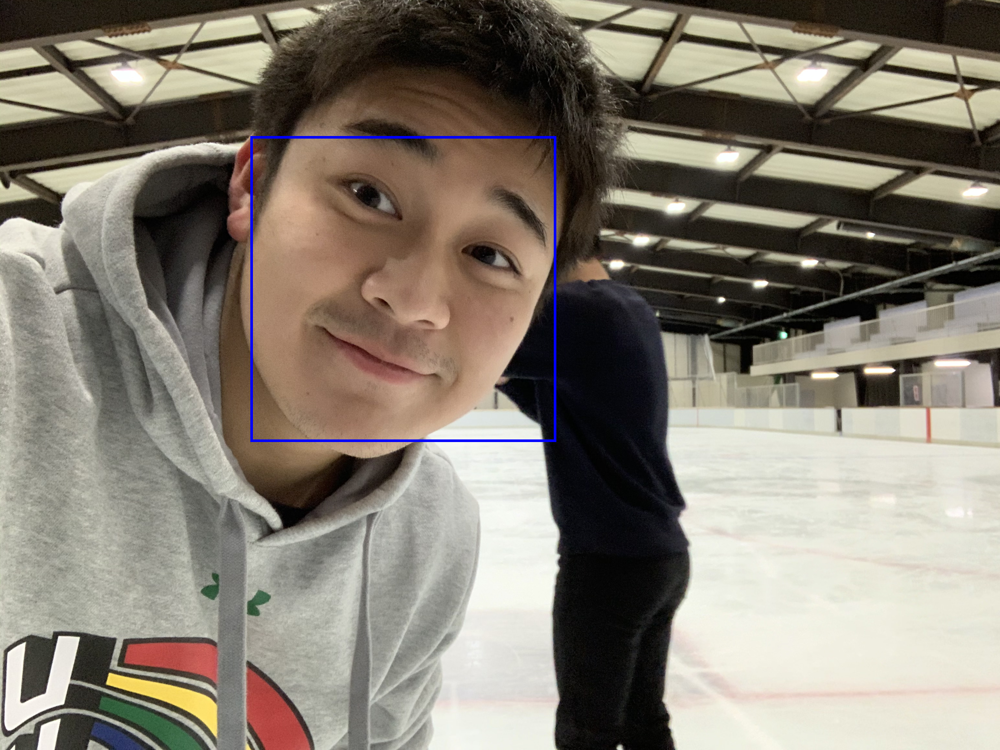

In [47]:
img

In [2]:
import requests
from PIL import Image
from PIL import ImageDraw
from PIL import ImageFont
import io
import json

with open('secrets.json') as f:
    secrets_json = json.load(f)
subscription_key = secrets.json['subscription_key']

assert subscription_key

face_api_url = 'https://cntr2020.cognitiveservices.azure.com/face/v1.0/detect'

img = Image.open('IMG_2214.jpg')
with io.BytesIO() as output:
    img.save(output, format="JPEG")
    binary_img = output.getvalue()
    
headers = {
    'Content-type': 'application/octet-stream',
    'Ocp-Apim-Subscription-Key': subscription_key
}

params = {
    'returnFaceId': 'true',
    'returnFaceAttributes': 'age,gender'
}

res = requests.post(face_api_url, params=params, headers=headers, data=binary_img)

results = res.json()


for result in results:
    rect = result['faceRectangle']
    fab = result['faceAttributes']
    draw = ImageDraw.Draw(img)
    text = fab.values()
    if fab['gender'] == 'male':
        draw.rectangle([(rect['left'], rect['top']), (rect['left']+rect['width']), (rect['top']+rect['height'])], fill=None, outline='blue', width=15)
    else:
        draw.rectangle([(rect['left'], rect['top']), (rect['left']+rect['width']), (rect['top']+rect['height'])], fill=None, outline='pink', width=15)
    
img

JSONDecodeError: Expecting value: line 2 column 26 (char 27)

In [16]:
import io

In [17]:
with io.BytesIO() as output:
    img.save(output, format="JPEG")
    binary_img = output.getvalue()

In [18]:
rect

{'top': 391, 'left': 1936, 'width': 64, 'height': 64}

In [19]:
params

{'returnFaceId': 'true', 'returnFaceAttributes': 'age,gender'}

In [20]:
results

[{'faceId': '67ec5bf3-d4c4-4d63-878a-693cad16ca72',
  'faceRectangle': {'top': 848, 'left': 2647, 'width': 613, 'height': 613},
  'faceAttributes': {'gender': 'female', 'age': 7.0}},
 {'faceId': '7e87e4a6-6daf-4bd8-865e-8bc30b9d1baa',
  'faceRectangle': {'top': 848, 'left': 945, 'width': 449, 'height': 449},
  'faceAttributes': {'gender': 'male', 'age': 8.0}},
 {'faceId': 'e7443f3a-7587-45d7-92d3-fdd041fa1555',
  'faceRectangle': {'top': 391, 'left': 1936, 'width': 64, 'height': 64},
  'faceAttributes': {'gender': 'male', 'age': 29.0}}]

In [21]:
fab = results[0]['faceAttributes']

In [22]:
fab

{'gender': 'female', 'age': 7.0}

In [3]:
fab

{'gender': 'male', 'age': 29.0}

In [4]:
type(fab)

dict

In [7]:
fab.values

<function dict.values>

In [8]:
print(fab.values)

<built-in method values of dict object at 0x7fb1944e9f80>


In [9]:
print fab

SyntaxError: Missing parentheses in call to 'print'. Did you mean print(fab)? (<ipython-input-9-939083315ab2>, line 1)

In [10]:
print(fab)

{'gender': 'male', 'age': 29.0}


In [12]:
print(fab.keys)

<built-in method keys of dict object at 0x7fb1944e9f80>


In [14]:
print(fab.values())

dict_values(['male', 29.0])


In [22]:
text = fab.values()
text

dict_values(['male', 29.0])

In [29]:
from PIL import Image, ImageDraw, ImageFont
# get an image
base = Image.open("IMG_2214.jpg").convert("RGBA")

# make a blank image for the text, initialized to transparent text color
txt = Image.new("RGBA", base.size, (255,255,255,0))

# get a font
fnt = ImageFont.truetype("/Library/Fonts/Arial Bold.ttf", 40)
# get a drawing context
d = ImageDraw.Draw(txt)

# draw text, half opacity
d.text((100,100), "Hello", font=fnt, fill=(255,255,255,128))
# draw text, full opacity
d.text((100,600), "World", font=fnt, fill=(255,255,255,255))

out = Image.alpha_composite(base, txt)

out.show()

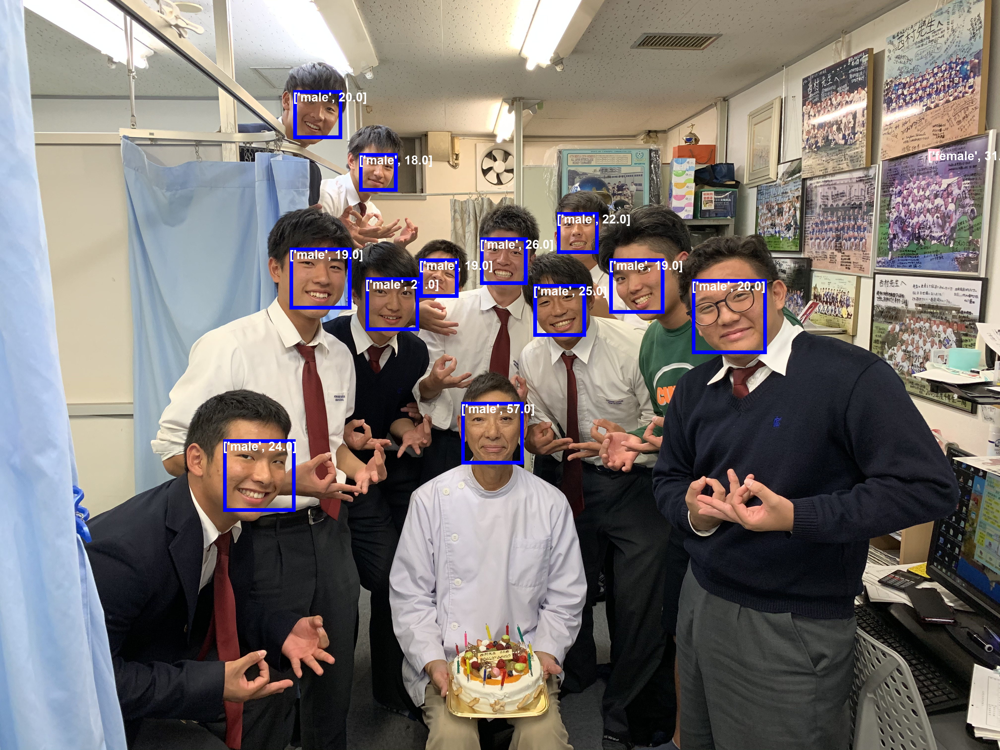

In [47]:
import requests
from PIL import Image
from PIL import ImageDraw
from PIL import ImageFont
import io

subscription_key = '32dbcc14bef049d5b3c381cdac8c7f53'
assert subscription_key

face_api_url = 'https://cntr2020.cognitiveservices.azure.com/face/v1.0/detect'

img = Image.open('IMG_3261.jpg')
with io.BytesIO() as output:
    img.save(output, format="JPEG")
    binary_img = output.getvalue()
    
headers = {
    'Content-type': 'application/octet-stream',
    'Ocp-Apim-Subscription-Key': subscription_key
}

params = {
    'returnFaceId': 'true',
    'returnFaceAttributes': 'age,gender'
}

res = requests.post(face_api_url, params=params, headers=headers, data=binary_img)

results = res.json()
fnt = ImageFont.truetype("/Library/Fonts/Arial Bold.ttf", 50)


for result in results:
    rect = result['faceRectangle']
    fab = result['faceAttributes']
    d = ImageDraw.Draw(img)
    text = str(list(fab.values()))
    
    if fab['gender'] == 'male':
        d.rectangle([(rect['left'], rect['top']), (rect['left']+rect['width']), (rect['top']+rect['height'])], fill=None, outline='blue', width=15)
        d.text((rect['left'], rect['top']), text, font=fnt, fill=(255,255,255,255))
    else:
        d.rectangle([(rect['left'], rect['top']), (rect['left']+rect['width']), (rect['top']+rect['height'])], fill=None, outline='pink', width=15)
        d.text((rect['left'], rect['top']), text, font=fnt, fill=(255,255,255,255))
    
img

In [37]:
type(text)

dict_values

In [6]:
import requests
import io
import json

with open('secret.json') as f:
    secret_json = json.load(f)
    
subscription_key = secret_json['subscription_key']
assert subscription_key


In [8]:
subscription_key

'32dbcc14bef049d5b3c381cdac8c7f53'